# PEC 4: Predicción de subtipos de cáncer de piel

### Raúl Pérez Prats

### 28/06/2024

## Tabla de Contenidos

### 1. [Exploración de los datos](#1)
#### [a) Visualización del dataset](#3)
#### [b) Distribución de las clases ](#4)
#### [c) Correlaciones entre las variables](#5)
#### [d) Distribución de las variables](#6)
#### [e) PCA](#7)
#### [f) Partición de los datos](#8)
### 2. [Entrenamiento Algoritmos](#2)
#### [a) Definimos funciones para entrenamiento y evaluación con CrossValidation y Matriz de Confusión](#9)
#### [b) k-Nearest Neighbour](#10)
#### [c) Naive Bayes](#11)
#### [d) Artificial Neural Network](#12)
#### [e) Support Vector Machine (SVM)](#13)
#### [f) Árbol de Clasificación](#14)
#### [g) Random Forest](#15)
### [3. Discusión y conclusión sobre el rendimiento de los algoritmos](#16)


## 1. Exploración de los datos<a class="anchor" id="1"></a>

### a) Visualización del dataset <a class="anchor" id="3"></a>

In [4]:
import pandas as pd
import numpy as np

In [5]:
# Cargamos dataset y lo printamos
df = pd.read_csv('rna1.csv')
df

,Class,RTN2,NDRG2,CCDC113,FAM63A,ACADS,GMDS,HLA.H,SEMA4A,ETS2,...,ELP2,ALOX5,AMN1,CERCAM,SEMA3C,KRT8,TP53INP2,JAM3,ZNF680,PBX1
0,tipus1,4.362183,7.533461,3.956124,4.457170,2.256817,6.017940,5.006907,3.217812,4.734446,...,6.581283,2.657454,4.015401,5.155279,7.709125,11.196906,5.564430,3.991982,3.352637,7.880923
1,tipus1,1.984492,7.455194,5.427623,5.440957,4.028813,4.341692,6.178668,2.864659,5.411029,...,7.150755,2.979337,2.948135,6.071058,6.657197,9.584007,5.923025,3.343699,3.637142,7.807082
2,tipus1,1.727323,8.079968,2.227300,5.543480,2.629855,6.363030,6.039563,5.946028,5.651670,...,6.430628,3.373541,3.063473,5.737308,3.978155,10.423796,5.980527,3.289314,3.633879,7.441712
3,tipus1,4.363996,5.793750,3.544866,4.737114,4.269101,4.001104,7.087633,5.007565,5.902449,...,5.606317,5.027281,2.883810,6.440455,6.891619,10.056940,4.939562,4.369947,3.987233,8.021253
4,tipus1,2.447562,7.158993,4.691256,4.808728,2.442135,7.029723,5.936138,5.901459,6.641225,...,5.903435,3.443978,3.883034,4.812939,3.298393,8.969229,6.410238,3.371594,3.264969,8.138553
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,tipus3,3.139900,6.222359,4.306467,6.912236,5.317992,4.686750,5.687450,5.601147,5.521284,...,9.362426,3.605044,3.197831,7.768923,8.317307,9.483178,6.554780,4.133490,4.692518,9.124810
146,tipus3,4.346977,5.708690,3.995944,6.189790,4.488860,3.186237,4.942399,4.299292,4.431560,...,7.542435,2.597901,4.246388,7.104121,8.440026,10.474549,5.216259,5.200584,5.630333,8.845085
147,tipus3,3.287485,5.043387,3.665758,5.943128,4.823124,5.077987,7.738051,1.269034,5.306115,...,7.036887,3.078385,5.007189,5.124937,6.601339,9.233522,6.155120,3.776062,4.961591,7.635797
148,tipus3,4.684112,6.274357,4.599318,5.335620,4.247261,3.627571,4.795321,5.166827,5.569633,...,6.514597,4.736976,2.858382,6.438251,9.214287,11.009129,5.093601,5.441528,4.920242,8.214355


In [6]:
df.shape

(150, 201)

Tenemos 150 muestras con 201 variables por muestra

In [7]:
df.isnull().sum()

Class       0
RTN2        0
NDRG2       0
CCDC113     0
FAM63A      0
           ..
KRT8        0
TP53INP2    0
JAM3        0
ZNF680      0
PBX1        0
Length: 201, dtype: int64

No hay valores nulos

In [8]:
df.describe()

,RTN2,NDRG2,CCDC113,FAM63A,ACADS,GMDS,HLA.H,SEMA4A,ETS2,LIMD2,...,ELP2,ALOX5,AMN1,CERCAM,SEMA3C,KRT8,TP53INP2,JAM3,ZNF680,PBX1
count,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,...,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000
mean,3.549331,6.010226,3.765484,5.325782,3.586201,4.554646,6.287433,5.310680,5.646845,3.993165,...,6.690897,4.044599,3.163258,6.241760,6.745951,10.040045,5.704509,4.552646,4.064911,8.179582
std,1.166884,1.387006,1.029216,1.071280,1.026817,0.992257,1.126872,0.910762,0.729253,1.248832,...,1.114015,1.056025,0.818416,1.004664,1.649374,0.974944,0.895641,0.944089,0.809947,1.027373
min,0.332753,3.310945,0.284974,1.840127,0.871557,1.983430,2.957603,1.269034,4.070387,1.359999,...,4.557966,0.711889,0.007847,2.366627,0.993065,6.021892,3.743292,2.146118,1.825176,5.025770
25%,2.811015,4.997007,3.269642,4.561730,3.006913,3.950741,5.574561,4.847977,5.167201,3.128148,...,5.975663,3.440536,2.697938,5.750151,5.785127,9.458731,5.086366,3.998902,3.550879,7.651604
50%,3.649901,5.888765,3.878613,5.437620,3.495100,4.540508,6.185800,5.289431,5.583607,3.779115,...,6.415541,4.002864,3.180001,6.389823,6.861410,10.046813,5.680902,4.624582,4.028637,8.309097
75%,4.393586,6.821142,4.308948,6.066787,4.227888,5.166531,7.009373,5.905983,6.067857,4.772383,...,7.172168,4.727061,3.760005,6.947495,8.029529,10.582126,6.272252,5.258124,4.601597,8.818342
max,6.142850,10.260165,7.685072,7.680580,6.577862,7.105627,9.130370,7.481899,7.971019,8.620600,...,9.811852,6.858711,5.057397,7.946967,10.357185,12.633154,8.724212,6.838215,6.256024,10.674363


Observamos un resúmen del dataset que incluye la media, la desviación estándar, los valores máximos y mínimos y los percentiles para cada variable

### b) Distribución de las clases <a class="anchor" id="4"></a>

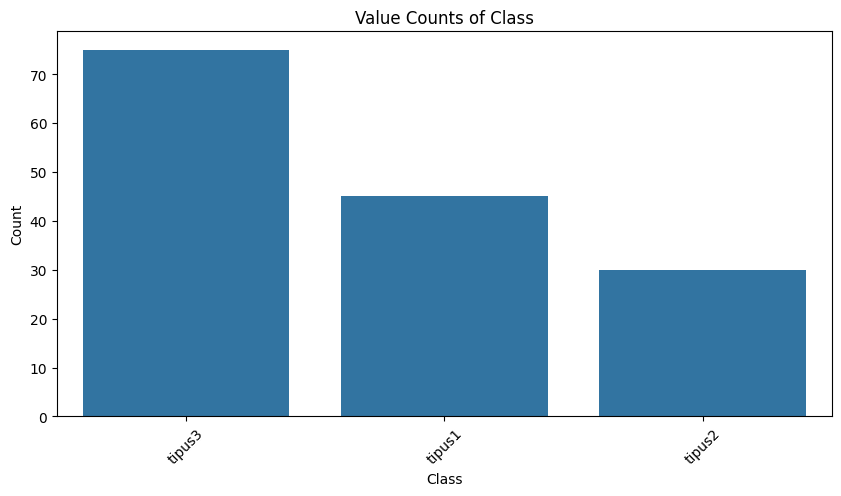

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Iteramos sobre las variables categoricas para crear barplot
for column in df.select_dtypes(include=['object']).columns:
    plt.figure(figsize=(10, 5))
    sns.countplot(x=df[column], order=df[column].value_counts().index)
    plt.title(f'Value Counts of {column}')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.xticks(rotation=45)  
    plt.show()



El gráfico de barras muestra el número de clases para cada tipo. Tenemos 3 clases no balanceadas, por lo tanto, se trata de un problema de 'mulitclass classification' con datos no balanceados.

### c) Correlaciones entre las variables <a class="anchor" id="5"></a>

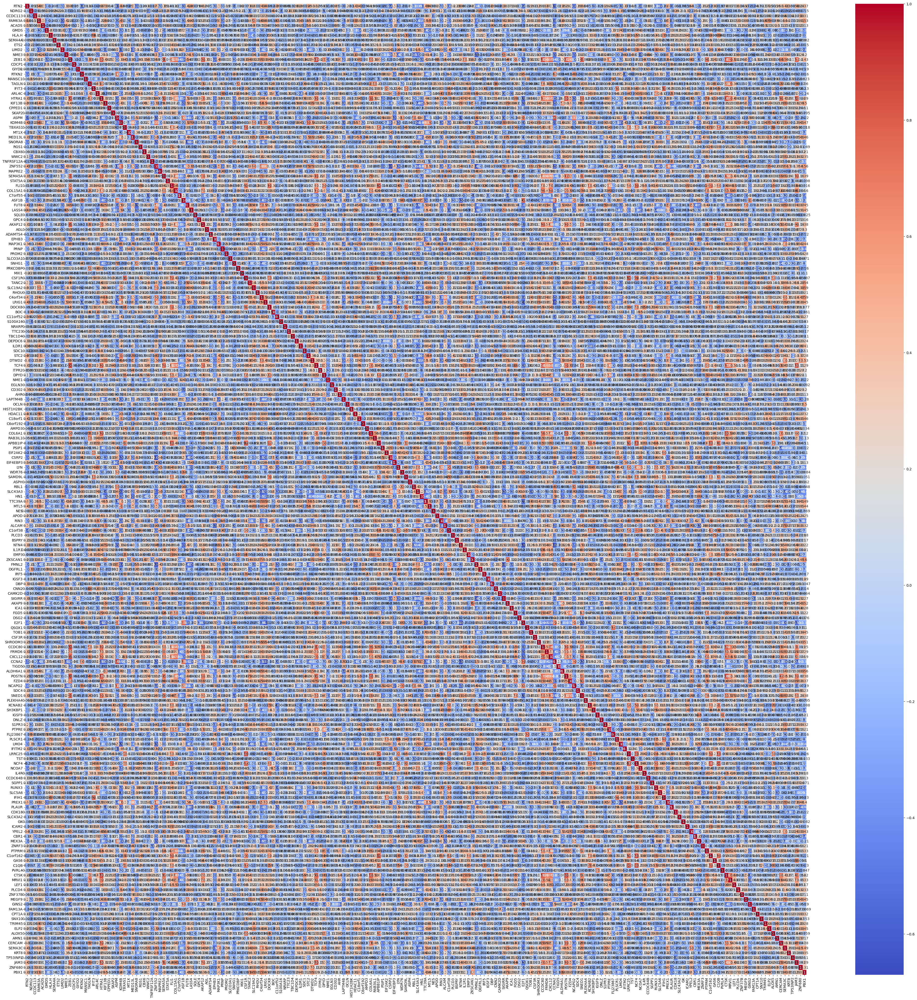

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt
# Añadimos a la X todas las variables predictoras
X = df.drop(['Class'], axis=1)
# Añadimos a la y la variable objetivo
y = df['Class']

plt.figure(figsize=(50, 50))
sns.heatmap(X.corr(), annot=True, cmap='coolwarm')
plt.show()

El heatmap muestra las correlaciones positivas y negativas entre las variables. Si hacemos zoom en la imagen podemos observar que existe una correlación positiva entre muchas variables, como podría ser JAM3 con ZEB1. Esto indica que cuando el RNA de una de estas variables se expresa, también aumenta la expresión de el otro.

### d) Distribución de las variables <a class="anchor" id="6"></a>

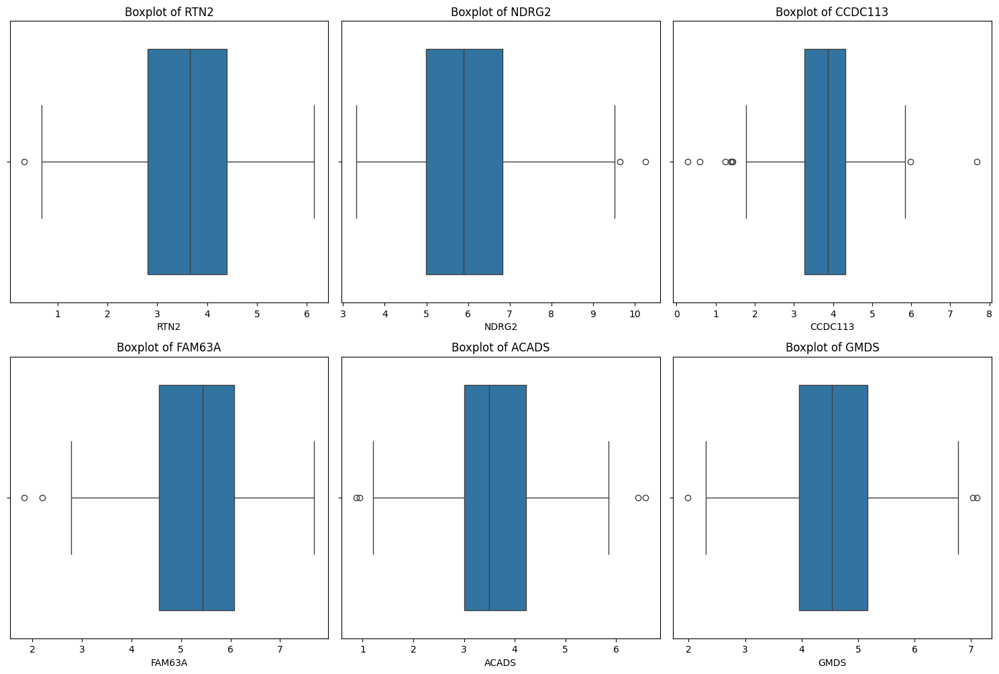

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns


# incluimos columnas numericas
num_cols = df.select_dtypes(include=['float64', 'int64']).columns

# Establecemos number of rows
plots_per_row = 3

# Calcula en numero de rows que necesita
num_rows = (len(num_cols) + plots_per_row - 1) // plots_per_row

# creamos subplots
fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(15, num_rows * 5))


axes = axes.flatten()

# Iteramos sobre las columnas
for i, column in enumerate(num_cols[:6]): # solo seleccionamos 6 porque si no ocupa mucho espacio en el report final en PDF
    sns.boxplot(x=df[column], ax=axes[i])
    axes[i].set_title(f'Boxplot of {column}')

# Eliminamos subplots no usados
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


Los gráficos de cajas y bigotes permiten observar la distribución de los valores de las muestras para cada variable predictora e identificar la presencia de posibles outliers, como es el caso de los gráficos NDRG2 y CCDC113

### e) PCA <a class="anchor" id="7"></a>

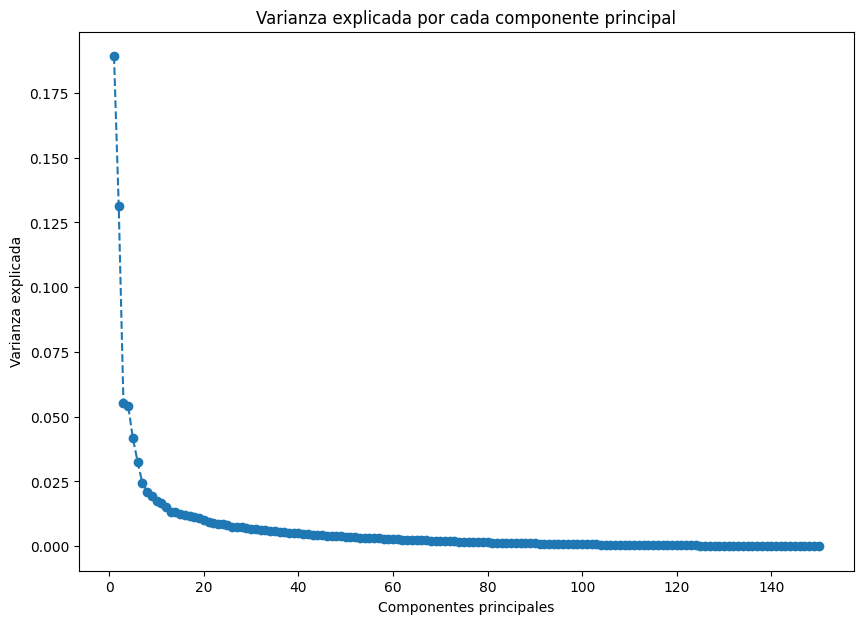

In [12]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Estandarizar los datos
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Crear un objeto PCA y ajustar los datos estandarizados
pca = PCA()
pca.fit(X_scaled)

# Transformar los datos
df_pca = pca.transform(X_scaled)

# Graficar la varianza explicada por cada componente principal
plt.figure(figsize=(10, 7))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, marker='o', linestyle='--')
plt.title('Varianza explicada por cada componente principal')
plt.xlabel('Componentes principales')
plt.ylabel('Varianza explicada')
plt.show()


Se observa como el % de varianza explicada por componente va disminuyendo a medida que aumentamos el número de componentes. 
El ópitmo de % por de varianza explicada por componente se encuentra en aquellas componentes antes de la componente principal número 20

In [13]:
# Varianza explicada por cada componente principal
explained_variance = pca.explained_variance_ratio_

# Cargas de cada variable en cada componente principal
loadings = pca.components_

# Crear un DataFrame para las cargas
loadings_df = pd.DataFrame(loadings, columns=X.columns)


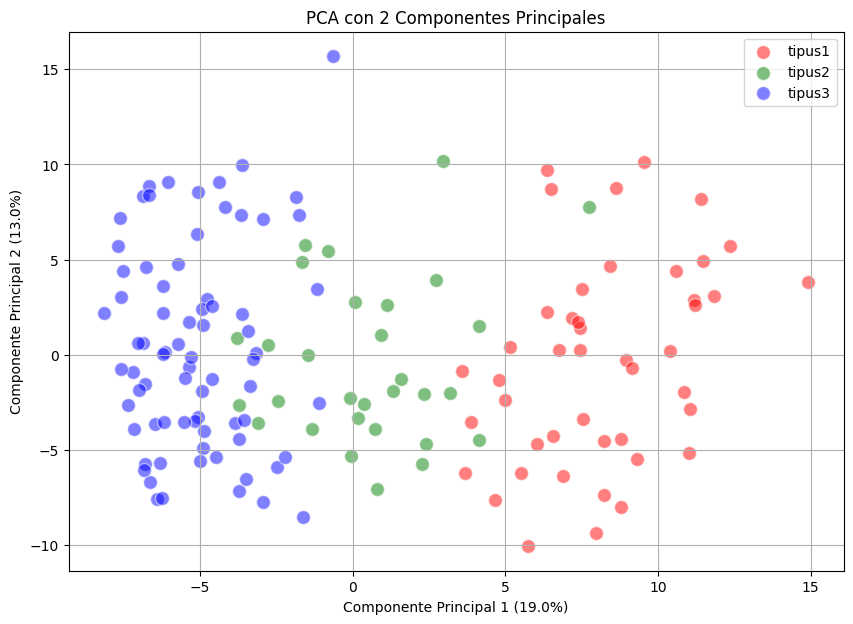

In [14]:
from matplotlib.colors import ListedColormap

# Crear un PCA que conserve 2 componentes principales
pca_2 = PCA(n_components=2)
df_pca_2 = pca_2.fit_transform(X_scaled)

# Crear un DataFrame con los resultados del PCA
df_pca_2 = pd.DataFrame(df_pca_2, columns=['PC1', 'PC2'])

explained_variance_ratio_2 = pca_2.explained_variance_ratio_

# Definir los colores para cada tipo
colormap = ListedColormap(['red', 'green', 'blue'])

df_pca_2['Tipo'] = y

# Crear la gráfica
plt.figure(figsize=(10, 7))


# Graficar cada tipo con su respectivo color
for i, tipo in enumerate(np.unique(y)):
    indices = df_pca_2['Tipo'] == tipo
    plt.scatter(df_pca_2.loc[indices, 'PC1'], df_pca_2.loc[indices, 'PC2'],
                color=colormap(i), label=tipo, alpha=0.5, edgecolors='w', s=100)

plt.xlabel(f'Componente Principal 1 ({round(explained_variance_ratio_2[0],2)*100}%)')
plt.ylabel(f'Componente Principal 2 ({round(explained_variance_ratio_2[1],2)*100}%)')
plt.title('PCA con 2 Componentes Principales')
plt.legend()
plt.grid(True)
plt.show()

En el PCA se observa claramente una separación entre los componentes principales de los diferentes tipos de cáncer sobre la componente principal 1. Esto es una excelente noticia, ya que al graficar las primeras dos componentes principales, que explican solo el 32% de la varianza total, podemos distinguir visualmente los tipos de cáncer. Cuando entrenemos un algoritmo que considere más variables, también podrá realizar esta distinción. El hecho de que con solo el 19% de la varianza explicada (componente principal 1) podamos separar los tipos de cáncer en un gráfico 2D sugiere que hay variables menos relevantes que podemos excluir durante el entrenamiento, reduciendo así la dimensionalidad y el coste computacional sin perder precisión ('accuracy').

### f) Partición de los datos <a class="anchor" id="8"></a>

In [15]:
from sklearn.model_selection import train_test_split

# División en conjunto de entrenamiento y prueba de forma estratificada para mitigar el efecto del desbalanceo de clases
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=12345,stratify=y)


## 2. Entrenamiento Algoritmos <a class="anchor" id="2"></a>

### a) Definimos funciones para entrenamiento y evaluación con CrossValidation y Matriz de Confusión <a class="anchor" id="9"></a>

In [16]:
import warnings

# Suprimir todos los warnings para que el pdf report quede limpio
warnings.filterwarnings('ignore')

In [17]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import make_scorer, accuracy_score, recall_score, precision_score, f1_score, roc_auc_score
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.metrics import confusion_matrix

def crossvalidation(modelo):
    
    # Define las métricas que quieres evaluar
    scoring = {
        'accuracy': make_scorer(accuracy_score),
        'recall': make_scorer(recall_score, average='weighted'),
        'precision': make_scorer(precision_score, average='weighted'),
        'f1': make_scorer(f1_score, average='weighted'),
    }
    
        
    # Realiza la validación cruzada de 3 folds
    cv_results = cross_validate(modelo, X, y, cv=3, scoring=scoring)
        
    # Calcula las medias de las métricas
    accuracy_mean = cv_results['test_accuracy'].mean()
    recall_mean = cv_results['test_recall'].mean()
    precision_mean = cv_results['test_precision'].mean()
    f1_mean = cv_results['test_f1'].mean()
        
    # Agrega los resultados a la lista
    results = {
        'parametros': k,
        'accuracy': accuracy_mean,
        'recall': recall_mean,
        'precision': precision_mean,
        'f1': f1_mean,
        }
        
    return results


def matriz_confusion(modelo):
    # Entrenamos
    modelo.fit(X_train, y_train)
    
    # Hacemos predicciones
    y_pred = modelo.predict(X_test)
    
    # Generamos la confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    
    # Define class labels (if applicable)
    class_names = np.unique(y)
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, cmap='Blues', fmt='d', cbar=False,
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.show()

### b) k-Nearest Neighbour <a class="anchor" id="10"></a>

In [18]:
values_knn = [1, 3, 5, 7, 11]
results_knn = []
for k in values_knn:
    result = crossvalidation(modelo = KNeighborsClassifier(n_neighbors=k))
    results_knn.append(result)

print("Resultados de validación cruzada:")
df_knn = pd.DataFrame(results_knn)
df_knn

Resultados de validación cruzada:


,parametros,accuracy,recall,precision,f1
0,1,0.900000,0.900000,0.902149,0.896391
1,3,0.913333,0.913333,0.920802,0.907258
2,5,0.913333,0.913333,0.916793,0.905750
3,7,0.900000,0.900000,0.907939,0.891610
4,11,0.906667,0.906667,0.910003,0.899598


El parámetro K = 3 es el óptimo, ya que muestra un rendimiento superior en todas las métricas, tan solo lo iguala k = 5 en accuracy y recall.

Hacemos una matriz de confusión para K = 3

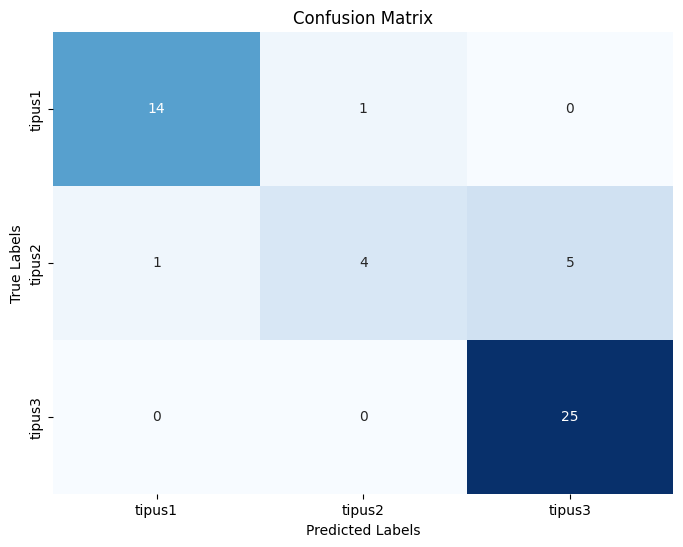

In [19]:
cm_knn = matriz_confusion(modelo=KNeighborsClassifier(n_neighbors=3))
cm_knn

 Vemos que clasifica correctamente todas las muestras de la clase tipus 1 y tipus 3. Tiene dificultades para clasificar correctamente 5 muestras de tipus 2 que las clasifica incorrectamente como tipus 3, 1 muestra de tipus 2 que la clasifica como tipus 1 y una muestra de tipus 1 que la clasifica como tipus 2. 

Si observamos el PCA anterior, se observa como algunos puntos pertenecientes a tipus 2 se mezclan con la nube de puntos tipus 3, de ahí que el KNN pueda haberse confundido en la clasificación, debido a que los centroides correspondientes al tipus 3 también actúa sobre estos puntos tipus 2 que se mezclan en los puntos tipus 3.

### c) Naive Bayes<a class="anchor" id="11"></a>

En scikit-learn, el suavizado de Laplace se controla a través del parámetro alpha en los clasificadores Naive Bayes:

- alpha = 0.0 significa sin suavizado (equivalente a Laplace=False).
- alpha > 0.0 activa el suavizado de Laplace (equivalente a Laplace=True).

In [20]:
from sklearn.naive_bayes import MultinomialNB
values_nb = [0,1]
results_nb = []
for k in values_nb:
    result = crossvalidation(modelo = MultinomialNB(alpha=k))
    results_nb.append(result)

print("Resultados de validación cruzada:")
df_nb = pd.DataFrame(results_nb)
df_nb

Resultados de validación cruzada:


,parametros,accuracy,recall,precision,f1
0,0,0.94,0.94,0.945483,0.940969
1,1,0.94,0.94,0.945483,0.940969


No se observan diferencias entre las métricas de evaluación cuando entrenamos el algoritmo Naive Bayes con alpha = 0 o alpha = 1. 
Esto es debido a que alpha = 1 agrega un 1 a todas las frecuencias observadas de características en las distribuciones de probabilidad. Esto se hace para evitar problemas con probabilidades condicionales que podrían ser cero cuando una característica no está presente en una categoría específica de datos.

Comprobamos si hay valores = 0 que podrían afectar el entrenamiento:

In [21]:
zero_check = X.isin([0]).any()
zero_check

RTN2        False
NDRG2       False
CCDC113     False
FAM63A      False
ACADS       False
            ...  
KRT8        False
TP53INP2    False
JAM3        False
ZNF680      False
PBX1        False
Length: 200, dtype: bool

Como no hay valores = 0 en nuestro dataset, el valor de alpha (activar o no Laplace) no es relevante para nuestras predicciones.

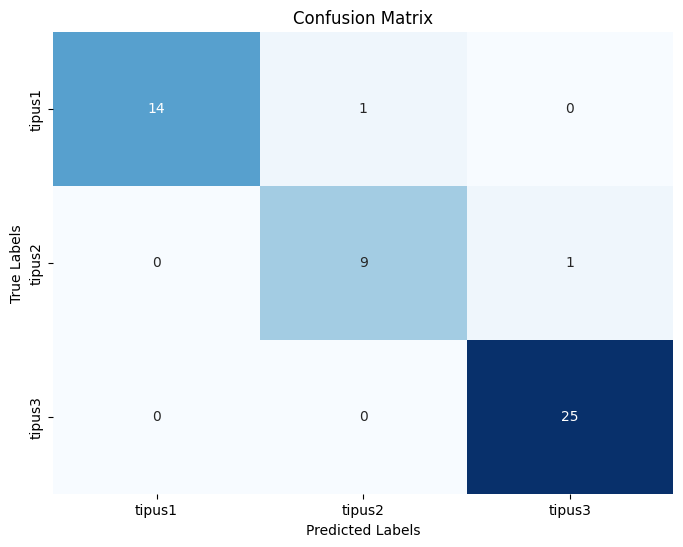

In [22]:
cm_nb = matriz_confusion(modelo=MultinomialNB(alpha=1))
cm_nb

El algoritmo Naive Bayes hace una muy buena clasificacion con un 94% de accuracy. Tan solo se equivoca en 2 muestras del TestSet: que clasifica como tipus 3 cuando en realidad se trata de tipus 2 y en tipus 2 cuando en realidad es tipus 1

### d) Artificial Neural Network <a class="anchor" id="12"></a>

Utilizaremos una arquitectura de multilayer perceptron (MLP) como modelo de red neuronal artifical para la clasificacion de subtipo de cáncer de piel

In [23]:
from sklearn.neural_network import MLPClassifier

capas_mlp = [(30,),(50,10)]
results_mlp = []
for k in capas_mlp:
    result = crossvalidation(modelo = MLPClassifier(hidden_layer_sizes=k, activation='relu', solver='adam', random_state=42))
    results_mlp.append(result)

print("Resultados de validación cruzada:")
df_mlp = pd.DataFrame(results_mlp)
df_mlp

Resultados de validación cruzada:


,parametros,accuracy,recall,precision,f1
0,"(30,)",0.940000,0.940000,0.942015,0.939584
1,"(50, 10)",0.926667,0.926667,0.929964,0.926041


El parámetro óptimo es de 1 sola capa con 30 neuronas, con una accuracy, recall, precisión y F1-score del 94% 

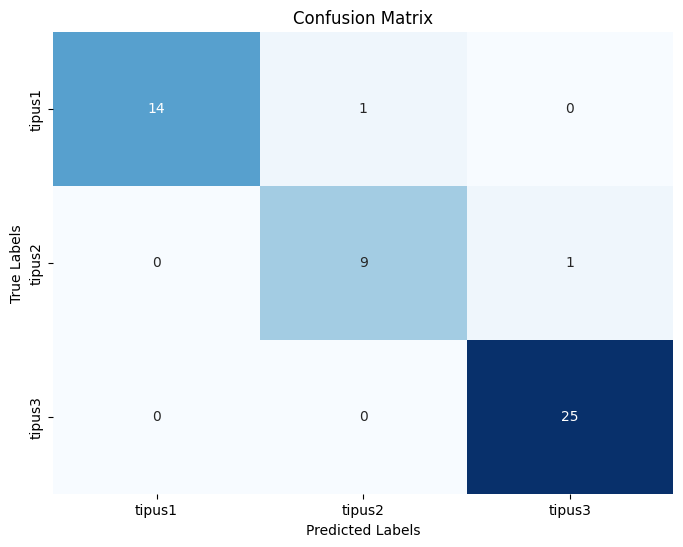

In [24]:
cm_mlp = matriz_confusion(modelo=MLPClassifier(hidden_layer_sizes=(30,), activation='relu', solver='adam', random_state=42))

El algoritmo MLP hace una buena clasificacion perfecta, igual que el algoritmo Naive Bayes, tan solo se equivoca en 2 muestras del TestSet: que clasifica como tipus 3 cuando en realidad se trata de tipus 2 y en tipus 2 cuando en realidad es tipus 1

### e) Support Vector Machine (SVM) <a class="anchor" id="13"></a>

In [25]:
from sklearn.svm import SVC
kernel = ['linear','rbf']
results_svc = []
for k in kernel:
    result = crossvalidation(modelo = SVC(kernel=k))
    results_svc.append(result)

print("Resultados de validación cruzada:")
df_svc = pd.DataFrame(results_svc)
df_svc

Resultados de validación cruzada:


,parametros,accuracy,recall,precision,f1
0,linear,0.933333,0.933333,0.938224,0.932688
1,rbf,0.946667,0.946667,0.948547,0.944175


El Kernel óptimo es 'rbf' debido a que obtiene métricas superiores al kernel 'linear' en todos los parámetros medidos

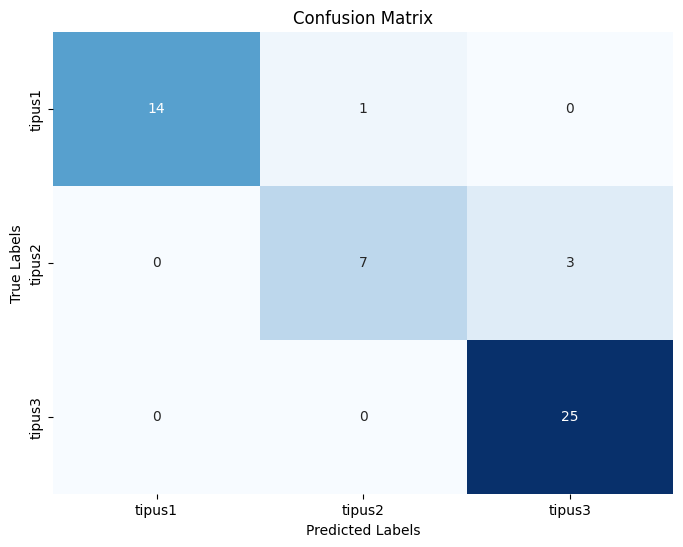

In [26]:
cm_svc = matriz_confusion(modelo = SVC(kernel='rbf'))

El SVC hace una buena clasificación, superando al KNN, aunque ligeramente inferior a los clasificadores MLP y Naive Bayes. Clasifica incorrectamente 3 muestras como tipus 3 cuando en realidad pertenecen a la clase tipus 2 y clasifica erroneamente 1 muestra como tipus 2 cuando realmente pertenece a la clase tipus 1

### f) Árbol de Clasificación <a class="anchor" id="14"></a>

El boosting aplicado a los árboles de clasificación (AdaBoost), es una técnica que combina múltiples clasificadores débiles (generalmente árboles de decisión simples) para formar un modelo robusto y preciso. En cada iteración, se ajustan los pesos de las instancias mal clasificadas para enfocarse en los casos más difíciles, mejorando gradualmente la precisión del modelo. Este enfoque es especialmente efectivo en conjuntos de datos desbalanceados, donde puede mejorar la detección de clases minoritarias al asignarles mayores pesos.

In [28]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier

boosting = [1,10,20,30,50] 
results_dt = []

for k in boosting:
    result = crossvalidation(modelo = AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=1), 
                                         n_estimators=k,  # Número de clasificadores débiles -> n_estimators = 1 equivale a suprimir el boosting
                                         algorithm='SAMME'))
    results_dt.append(result)

print("Resultados de validación cruzada:")
df_dt = pd.DataFrame(results_dt)
df_dt

Resultados de validación cruzada:


,parametros,accuracy,recall,precision,f1
0,1,0.686667,0.686667,0.554053,0.611639
1,10,0.753333,0.753333,0.769733,0.752457
2,20,0.826667,0.826667,0.836269,0.827343
3,30,0.840000,0.840000,0.847674,0.838904
4,50,0.860000,0.860000,0.867709,0.859641


El árbol de decisión funciona mejor con boosting y tiene una tendencia a mejorar su accuracy cuanto mayor es el número de estimadores (modelos débiles). De los valores probados, el número de estimadores que mejor resultados y rendimiento muestra es 50.

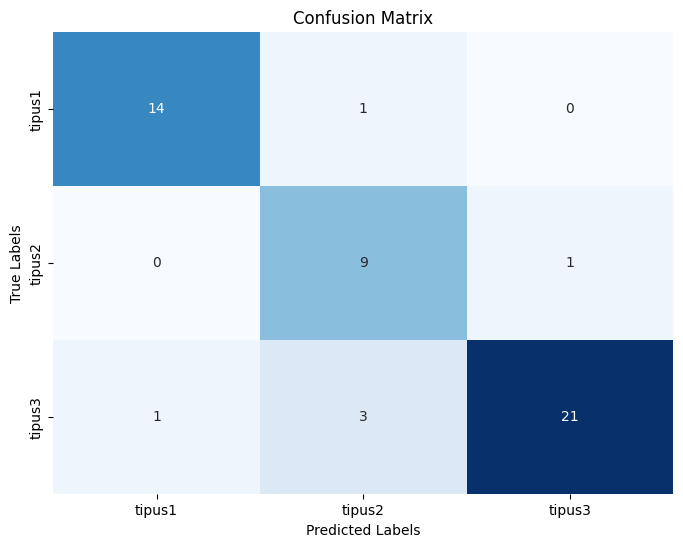

In [29]:
cm_dt = matriz_confusion(modelo = AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=1), 
                                         n_estimators=50,  # Número de clasificadores débiles
                                         algorithm='SAMME'))

Obtenemos una buena clasificación en la que el árbol de clasificación con boosting  falla en 6 muestras

### g) Random Forest <a class="anchor" id="15"></a>

Random Forest es un método de aprendizaje supervisado que utiliza múltiples árboles de decisión entrenados con diferentes subconjuntos de datos y características aleatorias. Combina las predicciones de estos árboles para mejorar la precisión y reducir el sobreajuste, siendo eficaz para grandes conjuntos de datos y variables de entrada. Es robusto frente al sobreajuste gracias a la diversidad de árboles y permite medir la importancia de las características.

In [30]:
from sklearn.ensemble import RandomForestClassifier
estimators = [100,200]
results_rf = []

for k in estimators:
    result = crossvalidation(modelo =RandomForestClassifier(n_estimators=k, random_state=42))
    results_rf.append(result)

print("Resultados de validación cruzada:")
df_rf = pd.DataFrame(results_rf)
df_rf


Resultados de validación cruzada:


,parametros,accuracy,recall,precision,f1
0,100,0.926667,0.926667,0.929791,0.923395
1,200,0.920000,0.920000,0.922428,0.915693


El random forest con un número de árboles = 100 tiene un rendimiento ligeramente superior al random forest con un número de árboles = 200

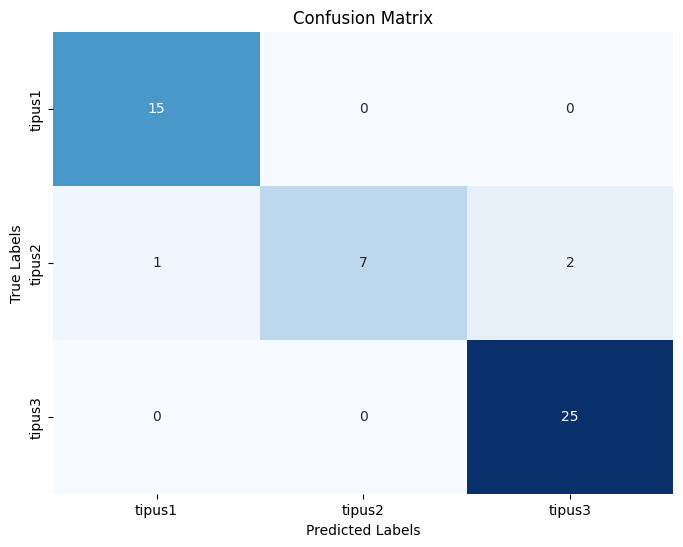

In [31]:
cm_rf = matriz_confusion(modelo = RandomForestClassifier(n_estimators=100, random_state=42))

El random forest hace una buena clasificacion pero clasifica 3 muestras de forma erronea: 2 en la clase tipus 3 cuando realmente pertenecen a la clase tipus 2 y 1 en la clase tipus 1 cuando realmente pertenece a la clase tipus 2

## 3. Discusión y conclusión sobre el rendimiento de los algoritmos <a class="anchor" id="16"></a>

In [32]:
modelos = {
            'KNN':KNeighborsClassifier(n_neighbors=3),
            'NB':MultinomialNB(alpha=1),
            'MLP':MLPClassifier(hidden_layer_sizes=(30,), activation='relu', solver='adam', random_state=42),
            'SVM':SVC(kernel='rbf'),
            'DT':AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=1), 
                                                     n_estimators=50,  # Número de clasificadores débiles
                                                     algorithm='SAMME'),
            'RF':RandomForestClassifier(n_estimators=100, random_state=42),
            }
results_total = []

for model_name, model in modelos.items():
    result = crossvalidation(modelo =model)
    result['Model'] =  model_name
    results_total.append(result)



df_total = pd.DataFrame(results_total).drop(['parametros'], axis = 1)

# Cambiamos orden columna Model
cols = list(df_total.columns)
cols = ['Model'] + [col for col in cols if col != 'Model']
df_total = df_total[cols]

df_sorted = df_total.sort_values(by='accuracy', ascending=False)
df_sorted



,Model,accuracy,recall,precision,f1
3,SVM,0.946667,0.946667,0.948547,0.944175
1,NB,0.940000,0.940000,0.945483,0.940969
2,MLP,0.940000,0.940000,0.942015,0.939584
5,RF,0.926667,0.926667,0.929791,0.923395
0,KNN,0.913333,0.913333,0.920802,0.907258
4,DT,0.860000,0.860000,0.867709,0.859641


Esta tabla muestra el rendimiento de todos los algoritmos de clasificacion implementados anteriormente, entrenados con los parámetros más óptimos probados.

El algoritmo que muestra un mejor rendimiento es el SVM con un kernel 'rbf' superior al resto de algoritmos en accuracy (94.66%), recall (94.66%), precision (94.85%) y F1-score (94.42%). El segundo mejor algoritmo es el Naive Bayes classifier con un 94.00% de accuracy, seguido del MLP (con una capa oculta de 30 unidades) con la misma accuracy y del random forest (n=100) con una accuracy del 92.66%. Los algoritmos que han mostrado un peor rendimiento son el KNN (accuracy = 91.33%) y el Decision Tree con boosting (accuracy = 86.00%).

En este ejercicio hemos explorado y analizado los datos RNA-seq de expresión de 3 tipos diferentes de cáncer de piel. Hemos demostrado que existen diferencias apreciables a simple vista entre los datos de expresión de los 3 tipos de cáncer mediante un PCA plot. Además, hemos entrenado y optimizado 6 algoritmos distintos mediante un 'Cross Validation 3 folds' para la predicción de la clasificación de las variables en estos 3 tipos y hemos comparado que algoritmos son los mejores y cuáles son sus fallos. Finalmente hemos obtenido una accuracy máxima de 94.66% con un SVM.